# **Prediction drift report**

In [22]:
!pip install xgboost --quiet

In [23]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import MaxAbsScaler, LabelEncoder
from xgboost import XGBClassifier
from evidently.report import Report
from evidently.pipeline.column_mapping import ColumnMapping
from evidently.metric_preset import DataDriftPreset, TargetDriftPreset, ClassificationPreset

In [34]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from sklearn.metrics import (
    roc_curve, auc, precision_recall_curve, average_precision_score,
    confusion_matrix, classification_report, accuracy_score,
    f1_score, precision_score, recall_score, roc_auc_score
)
import plotly.graph_objects as go
from plotly.subplots import make_subplots

In [24]:
print("Reference loan_status:")
print(reference['loan_status'].value_counts())
print("\nProduction loan_status:")
print(production['loan_status'].value_counts())

Reference loan_status:
loan_status
Fully Paid     1041953
Charged Off     260371
Name: count, dtype: int64

Production loan_status:
loan_status
Fully Paid     1076751
Charged Off     268559
Name: count, dtype: int64


In [25]:
numeric_features = [
    'loan_amnt', 'funded_amnt', 'funded_amnt_inv', 'int_rate', 'installment',
    'annual_inc', 'dti', 'delinq_2yrs', 'fico_range_low', 'fico_range_high',
    'inq_last_6mths', 'mths_since_last_delinq', 'mths_since_last_record',
    'open_acc', 'pub_rec', 'revol_bal', 'revol_util', 'total_acc',
    'last_fico_range_high', 'last_fico_range_low', 'collections_12_mths_ex_med',
    'acc_now_delinq', 'tot_coll_amt', 'tot_cur_bal', 'open_acc_6m',
    'open_act_il', 'open_il_12m', 'open_il_24m', 'total_bal_il',
    'il_util', 'open_rv_12m', 'open_rv_24m', 'max_bal_bc', 'all_util',
    'total_rev_hi_lim', 'inq_fi', 'total_cu_tl', 'inq_last_12m',
    'acc_open_past_24mths', 'avg_cur_bal', 'bc_open_to_buy', 'bc_util',
    'mort_acc', 'num_accts_ever_120_pd', 'num_actv_bc_tl', 'num_actv_rev_tl',
    'num_bc_sats', 'num_bc_tl', 'num_il_tl', 'num_op_rev_tl', 'num_rev_accts',
    'num_rev_tl_bal_gt_0', 'num_sats', 'num_tl_op_past_12m', 'pct_tl_nvr_dlq',
    'percent_bc_gt_75', 'pub_rec_bankruptcies', 'tax_liens', 'tot_hi_cred_lim',
    'total_bal_ex_mort', 'total_bc_limit', 'total_il_high_credit_limit'
]


feature_cols = [f for f in numeric_features if f in reference.columns and f in production.columns]
print(f"Using {len(feature_cols)} features")

Using 62 features


In [26]:
target_col = 'loan_status'

# features and target.
ref_data = reference[feature_cols + [target_col]].copy()
prod_data = production[feature_cols + [target_col]].copy()

# filling missing values with the median.
for col in feature_cols:
    median_val = ref_data[col].median()
    ref_data[col] = ref_data[col].fillna(median_val)
    prod_data[col] = prod_data[col].fillna(median_val)

# dropping NaN in target.
ref_data = ref_data.dropna(subset=[target_col])
prod_data = prod_data.dropna(subset=[target_col])

# encoding target.
le = LabelEncoder()
ref_data['target'] = le.fit_transform(ref_data[target_col].astype(str))
prod_data['target'] = le.transform(prod_data[target_col].astype(str))

print(f"Classes: {dict(zip(le.classes_, range(len(le.classes_))))}")
print(f"Reference: {ref_data.shape}, Production: {prod_data.shape}")

Classes: {'Charged Off': 0, 'Fully Paid': 1}
Reference: (1302324, 64), Production: (1345310, 64)


In [28]:
# training the Azure model: MaxAbsScaler + XGBoost

X_ref = ref_data[feature_cols]
y_ref = ref_data['target']

# MaxAbsScaler.
scaler = MaxAbsScaler()
X_ref_scaled = scaler.fit_transform(X_ref)

# XGBoost Classifier.
model = XGBClassifier(
    n_estimators=100,
    max_depth=6,
    learning_rate=0.1,
    random_state=42,
    eval_metric='auc'
)
model.fit(X_ref_scaled, y_ref)

print("Model trained (MaxAbsScaler + XGBoostClassifier)")

Model trained (MaxAbsScaler + XGBoostClassifier)


In [29]:
# predictions.

X_prod = prod_data[feature_cols]
X_prod_scaled = scaler.transform(X_prod)

ref_data['prediction'] = model.predict(X_ref_scaled)
ref_data['prediction_proba'] = model.predict_proba(X_ref_scaled)[:, 1]

prod_data['prediction'] = model.predict(X_prod_scaled)
prod_data['prediction_proba'] = model.predict_proba(X_prod_scaled)[:, 1]

print("Reference predictions:", ref_data['prediction'].value_counts().to_dict())
print("Production predictions:", prod_data['prediction'].value_counts().to_dict())

Reference predictions: {1: 1047256, 0: 255068}
Production predictions: {1: 1176489, 0: 168821}


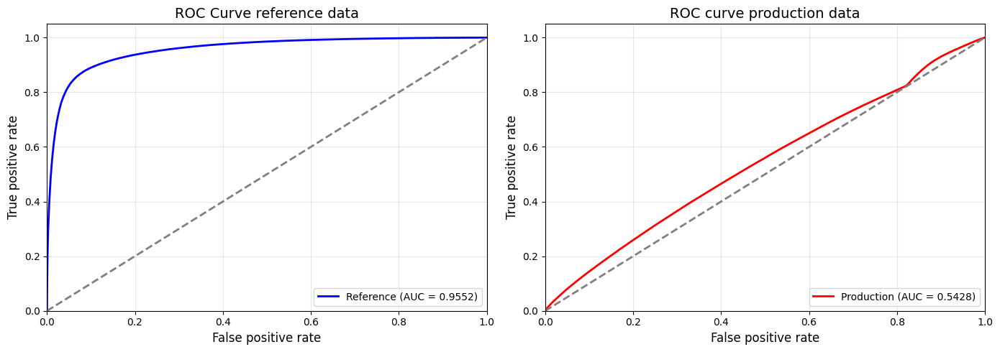

AUC comparison:
   Reference AUC: 0.9552
   Production AUC: 0.5428
   AUC drift: 0.4125


In [51]:
# 1. ROC curve (reference vs production)

fig, axes = plt.subplots(1, 2, figsize=(14, 5))

# reference ROC.
fpr_ref, tpr_ref, _ = roc_curve(ref_data['target'], ref_data['prediction_proba'])
roc_auc_ref = auc(fpr_ref, tpr_ref)

axes[0].plot(fpr_ref, tpr_ref, color='blue', lw=2, label=f'Reference (AUC = {roc_auc_ref:.4f})')
axes[0].plot([0, 1], [0, 1], color='gray', lw=2, linestyle='--')
axes[0].set_xlim([0.0, 1.0])
axes[0].set_ylim([0.0, 1.05])
axes[0].set_xlabel('False positive rate', fontsize=12)
axes[0].set_ylabel('True positive rate', fontsize=12)
axes[0].set_title('ROC Curve reference data', fontsize=14)
axes[0].legend(loc="lower right")
axes[0].grid(True, alpha=0.3)

# production ROC.
fpr_prod, tpr_prod, _ = roc_curve(prod_data['target'], prod_data['prediction_proba'])
roc_auc_prod = auc(fpr_prod, tpr_prod)

axes[1].plot(fpr_prod, tpr_prod, color='red', lw=2, label=f'Production (AUC = {roc_auc_prod:.4f})')
axes[1].plot([0, 1], [0, 1], color='gray', lw=2, linestyle='--')
axes[1].set_xlim([0.0, 1.0])
axes[1].set_ylim([0.0, 1.05])
axes[1].set_xlabel('False positive rate', fontsize=12)
axes[1].set_ylabel('True positive rate', fontsize=12)
axes[1].set_title('ROC curve production data', fontsize=14)
axes[1].legend(loc="lower right")
axes[1].grid(True, alpha=0.3)

plt.tight_layout()
plt.savefig('roc_curves.png', dpi=150, bbox_inches='tight')
plt.show()

print(f"AUC comparison:")
print(f"   Reference AUC: {roc_auc_ref:.4f}")
print(f"   Production AUC: {roc_auc_prod:.4f}")
print(f"   AUC drift: {abs(roc_auc_ref - roc_auc_prod):.4f}")

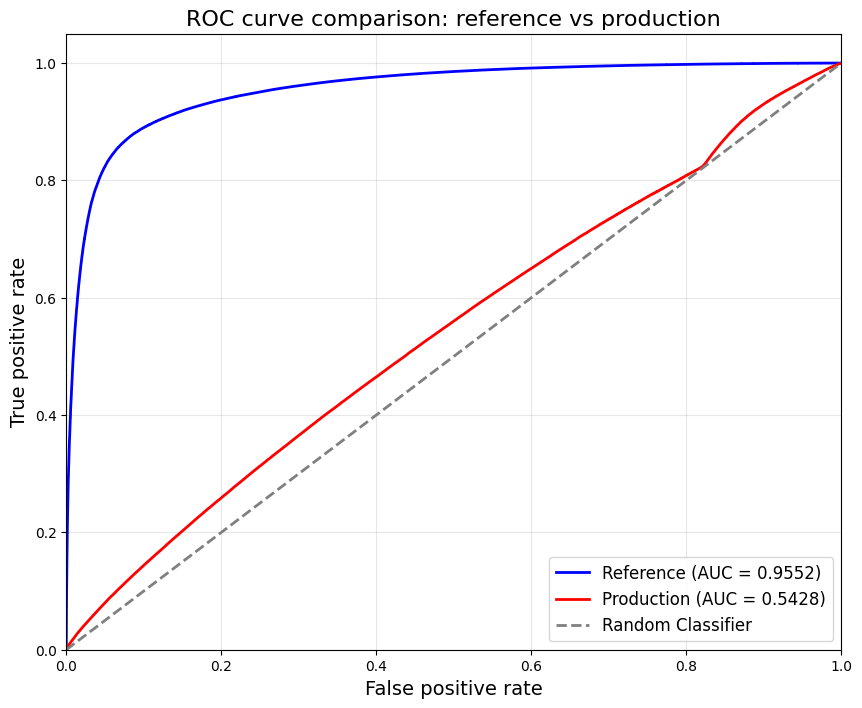

In [52]:
# 2. ROC curves comparision.

plt.figure(figsize=(10, 8))

plt.plot(fpr_ref, tpr_ref, color='blue', lw=2, label=f'Reference (AUC = {roc_auc_ref:.4f})')
plt.plot(fpr_prod, tpr_prod, color='red', lw=2, label=f'Production (AUC = {roc_auc_prod:.4f})')
plt.plot([0, 1], [0, 1], color='gray', lw=2, linestyle='--', label='Random Classifier')

plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False positive rate', fontsize=14)
plt.ylabel('True positive rate', fontsize=14)
plt.title('ROC curve comparison: reference vs production', fontsize=16)
plt.legend(loc="lower right", fontsize=12)
plt.grid(True, alpha=0.3)

plt.savefig('roc_comparison.png', dpi=150, bbox_inches='tight')
plt.show()

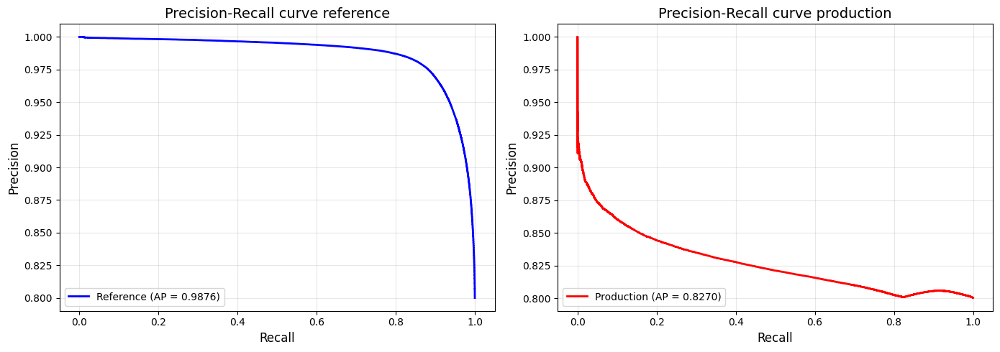

Average precision comparison:
   Reference AP: 0.9876
   Production AP: 0.8270


In [53]:
# 3. Precision-reall curves

fig, axes = plt.subplots(1, 2, figsize=(14, 5))

# reference PR curve.
precision_ref, recall_ref, _ = precision_recall_curve(ref_data['target'], ref_data['prediction_proba'])
ap_ref = average_precision_score(ref_data['target'], ref_data['prediction_proba'])

axes[0].plot(recall_ref, precision_ref, color='blue', lw=2, label=f'Reference (AP = {ap_ref:.4f})')
axes[0].set_xlabel('Recall', fontsize=12)
axes[0].set_ylabel('Precision', fontsize=12)
axes[0].set_title('Precision-Recall curve reference', fontsize=14)
axes[0].legend(loc="lower left")
axes[0].grid(True, alpha=0.3)

# production PR curve.
precision_prod, recall_prod, _ = precision_recall_curve(prod_data['target'], prod_data['prediction_proba'])
ap_prod = average_precision_score(prod_data['target'], prod_data['prediction_proba'])

axes[1].plot(recall_prod, precision_prod, color='red', lw=2, label=f'Production (AP = {ap_prod:.4f})')
axes[1].set_xlabel('Recall', fontsize=12)
axes[1].set_ylabel('Precision', fontsize=12)
axes[1].set_title('Precision-Recall curve production', fontsize=14)
axes[1].legend(loc="lower left")
axes[1].grid(True, alpha=0.3)

plt.tight_layout()
plt.savefig('pr_curves.png', dpi=150, bbox_inches='tight')
plt.show()

print(f"Average precision comparison:")
print(f"   Reference AP: {ap_ref:.4f}")
print(f"   Production AP: {ap_prod:.4f}")

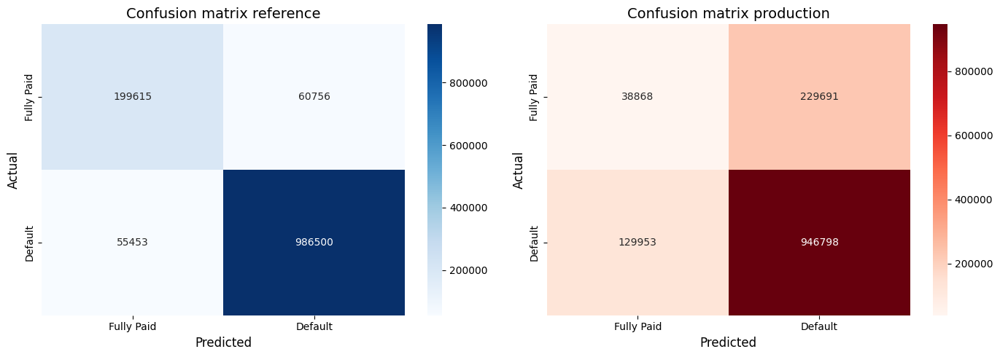

In [54]:
# 4. Confusion matrix.

fig, axes = plt.subplots(1, 2, figsize=(14, 5))

# reference confusion matrix.
cm_ref = confusion_matrix(ref_data['target'], ref_data['prediction'])
sns.heatmap(cm_ref, annot=True, fmt='d', cmap='Blues', ax=axes[0],
            xticklabels=['Fully Paid', 'Default'],
            yticklabels=['Fully Paid', 'Default'])
axes[0].set_xlabel('Predicted', fontsize=12)
axes[0].set_ylabel('Actual', fontsize=12)
axes[0].set_title('Confusion matrix reference', fontsize=14)

# production confusion matrix.
cm_prod = confusion_matrix(prod_data['target'], prod_data['prediction'])
sns.heatmap(cm_prod, annot=True, fmt='d', cmap='Reds', ax=axes[1],
            xticklabels=['Fully Paid', 'Default'],
            yticklabels=['Fully Paid', 'Default'])
axes[1].set_xlabel('Predicted', fontsize=12)
axes[1].set_ylabel('Actual', fontsize=12)
axes[1].set_title('Confusion matrix production', fontsize=14)

plt.tight_layout()
plt.savefig('confusion_matrices.png', dpi=150, bbox_inches='tight')
plt.show()

In [55]:
# 6. Model performance metric comparision.

def calculate_metrics(y_true, y_pred, y_proba):
    return {
        'Accuracy': accuracy_score(y_true, y_pred),
        'Precision': precision_score(y_true, y_pred),
        'Recall': recall_score(y_true, y_pred),
        'F1 Score': f1_score(y_true, y_pred),
        'AUC-ROC': roc_auc_score(y_true, y_proba),
        'Average precision': average_precision_score(y_true, y_proba)
    }

metrics_ref = calculate_metrics(ref_data['target'], ref_data['prediction'], ref_data['prediction_proba'])
metrics_prod = calculate_metrics(prod_data['target'], prod_data['prediction'], prod_data['prediction_proba'])

metrics_df = pd.DataFrame({
    'Metric': list(metrics_ref.keys()),
    'Reference': list(metrics_ref.values()),
    'Production': list(metrics_prod.values())
})
metrics_df['Drift'] = abs(metrics_df['Reference'] - metrics_df['Production'])
metrics_df['Drift %'] = (metrics_df['Drift'] / metrics_df['Reference'] * 100).round(2)

print("Model performance comparision")
print("-"*70)
print(metrics_df.to_string(index=False))

Model performance comparision
----------------------------------------------------------------------
           Metric  Reference  Production    Drift  Drift %
         Accuracy   0.910768    0.732668 0.178100    19.55
        Precision   0.941986    0.804766 0.137220    14.57
           Recall   0.946780    0.879310 0.067470     7.13
         F1 Score   0.944377    0.840388 0.103988    11.01
          AUC-ROC   0.955247    0.542766 0.412480    43.18
Average precision   0.987581    0.827033 0.160547    16.26


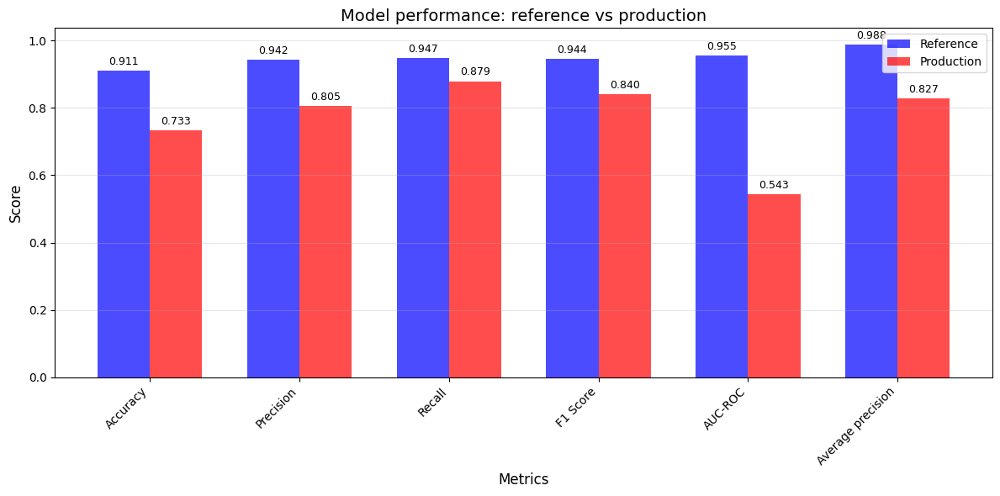

In [56]:
# 7. Metrics bar chart comparision

fig, ax = plt.subplots(figsize=(12, 6))

x = np.arange(len(metrics_df['Metric']))
width = 0.35

bars1 = ax.bar(x - width/2, metrics_df['Reference'], width, label='Reference', color='blue', alpha=0.7)
bars2 = ax.bar(x + width/2, metrics_df['Production'], width, label='Production', color='red', alpha=0.7)

ax.set_xlabel('Metrics', fontsize=12)
ax.set_ylabel('Score', fontsize=12)
ax.set_title('Model performance: reference vs production', fontsize=14)
ax.set_xticks(x)
ax.set_xticklabels(metrics_df['Metric'], rotation=45, ha='right')
ax.legend()
ax.grid(True, alpha=0.3, axis='y')

for bar in bars1:
    height = bar.get_height()
    ax.annotate(f'{height:.3f}', xy=(bar.get_x() + bar.get_width()/2, height),
                xytext=(0, 3), textcoords="offset points", ha='center', va='bottom', fontsize=9)

for bar in bars2:
    height = bar.get_height()
    ax.annotate(f'{height:.3f}', xy=(bar.get_x() + bar.get_width()/2, height),
                xytext=(0, 3), textcoords="offset points", ha='center', va='bottom', fontsize=9)

plt.tight_layout()
plt.savefig('metrics_comparison.png', dpi=150, bbox_inches='tight')
plt.show()

In [58]:
# 8. ROC curve

fig = go.Figure()

fig.add_trace(go.Scatter(x=fpr_ref, y=tpr_ref, mode='lines', name=f'Reference (AUC={roc_auc_ref:.4f})',
                         line=dict(color='blue', width=2)))
fig.add_trace(go.Scatter(x=fpr_prod, y=tpr_prod, mode='lines', name=f'Production (AUC={roc_auc_prod:.4f})',
                         line=dict(color='red', width=2)))
fig.add_trace(go.Scatter(x=[0, 1], y=[0, 1], mode='lines', name='Random',
                         line=dict(color='gray', width=2, dash='dash')))

fig.update_layout(
    title='ROC curve comparison',
    xaxis_title='False positive rate',
    yaxis_title='True positive rate',
    width=800, height=600,
    legend=dict(x=0.6, y=0.1)
)

fig.write_html('interactive_roc.html')
fig.show()